# Object Detection Demo
Welcome to the object detection inference walkthrough!  This notebook will walk you step by step through the process of using a pre-trained model to detect objects in an image. Make sure to follow the [installation instructions](https://github.com/tensorflow/models/blob/master/research/object_detection/g3doc/installation.md) before you start.

# Imports

In [2]:
import numpy as np
import os
import six.moves.urllib as urllib
import sys
import tarfile
import tensorflow as tf
import zipfile

from distutils.version import StrictVersion
from collections import defaultdict
from io import StringIO
from matplotlib import pyplot as plt
from PIL import Image

# This is needed since the notebook is stored in the object_detection folder.
sys.path.append("..")
from object_detection.utils import ops as utils_ops
from object_detection.builders import model_builder
from google.protobuf import text_format
import tensorflow as tf
from object_detection.protos import model_pb2
import time
from IPython.display import clear_output
from keras.models import load_model
import keras.backend as K
from math import floor, ceil
import cv2

if StrictVersion(tf.__version__) < StrictVersion('1.9.0'):
  raise ImportError('Please upgrade your TensorFlow installation to v1.9.* or later!')


## Env setup

In [3]:
# This is needed to display the images.
%matplotlib inline

## Object detection imports
Here are the imports from the object detection module.

In [4]:
from utils import label_map_util

from utils import visualization_utils as vis_util

../utils/visualization_utils.py:26: UserWarning: 
This call to matplotlib.use() has no effect because the backend has already
been chosen; matplotlib.use() must be called *before* pylab, matplotlib.pyplot,
or matplotlib.backends is imported for the first time.

The backend was *originally* set to 'module://ipykernel.pylab.backend_inline' by the following code:
  File "/home/wc-gpu/anaconda3/lib/python3.6/runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "/home/wc-gpu/anaconda3/lib/python3.6/runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "/home/wc-gpu/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "/home/wc-gpu/anaconda3/lib/python3.6/site-packages/traitlets/config/application.py", line 658, in launch_instance
    app.start()
  File "/home/wc-gpu/anaconda3/lib/python3.6/site-packages/ipykernel/kernelapp.py", line 505, in start
    self.io_loop.start()
  File "/home/wc

# Model preparation 

## Variables

Any model exported using the `export_inference_graph.py` tool can be loaded here simply by changing `PATH_TO_FROZEN_GRAPH` to point to a new .pb file.  

By default we use an "SSD with Mobilenet" model here. See the [detection model zoo](https://github.com/tensorflow/models/blob/master/research/object_detection/g3doc/detection_model_zoo.md) for a list of other models that can be run out-of-the-box with varying speeds and accuracies.

In [5]:
# What model to download.
# MODEL_NAME = '../prod_faster_rcnn_resnet50_coco_res_512x384_iou_genration'
MODEL_NAME = '../training2019.04.07-iou0.6io20.6/keep'

# MODEL_NAME = 'faster_rcnn_resnet50_coco_2018_01_28'
# MODEL_NAME = 'faster_rcnn_inception_resnet_v2_atrous_coco_2018_01_28'

MODEL_FILE = MODEL_NAME + '.tar.gz'
DOWNLOAD_BASE = 'http://download.tensorflow.org/models/object_detection/'

# Path to frozen detection graph. This is the actual model that is used for the object detection.
PATH_TO_FROZEN_GRAPH = MODEL_NAME + '/frozen_inference_graph.pb'
# PATH_TO_FROZEN_GRAPH = MODEL_NAME + '/saved_model.pb'

# List of the strings that is used to add correct label for each box.
PATH_TO_LABELS = os.path.join('data', 'mscoco_label_map.pbtxt')

# For the sake of simplicity we will use only 2 images:
# image1.jpg
# image2.jpg
# If you want to test the code with your images, just add path to the images to the TEST_IMAGE_PATHS.
test_image_path = "/home/wc-gpu/MasterThesis/session_data/122923_testing"
# test_image_path = "/Users/mbaltac/Home/MasterThesis/MasterThesis/labeled_images_shopping_sessions/labeled/122923_testing"
TEST_IMAGE_PATHS = sorted([os.path.join(test_image_path, f) for f in os.listdir(test_image_path) if f.endswith("jpg")])


# TEST_IMAGE_PATHS = [TEST_IMAGE_PATHS[0], TEST_IMAGE_PATHS[0]]


# Size, in inches, of the output images.
IMAGE_SIZE = (18, 12)

SESSIONS_PATH = "/home/wc-gpu/storage4tb/session_data_thesis/sessions160000_165000"

## Download Model

In [6]:
# opener = urllib.request.URLopener()
# opener.retrieve(DOWNLOAD_BASE + MODEL_FILE, MODEL_FILE)
# tar_file = tarfile.open(MODEL_FILE)
# for file in tar_file.getmembers():
#   file_name = os.path.basename(file.name)
#   if 'frozen_inference_graph.pb' in file_name:
#     tar_file.extract(file, os.getcwd())

## Load a (frozen) Tensorflow model into memory.

In [7]:
# with tf.Graph().as_default():
#   od_graph_def = tf.GraphDef()
#   with tf.gfile.GFile(PATH_TO_FROZEN_GRAPH, 'rb') as fid:
#     serialized_graph = fid.read()
#     od_graph_def.ParseFromString(serialized_graph)
#     tf.import_graph_def(od_graph_def, name='')

## Loading label map
Label maps map indices to category names, so that when our convolution network predicts `5`, we know that this corresponds to `airplane`.  Here we use internal utility functions, but anything that returns a dictionary mapping integers to appropriate string labels would be fine

In [8]:
# category_index = label_map_util.create_category_index_from_labelmap(PATH_TO_LABELS, use_display_name=True)

In [9]:
category_index = {1: {'id': 1, 'name': 'product'},
 2: {'id': 2, 'name': 'add'},
 3: {'id': 3, 'name': 'remove'},
 4: {'id': 4, 'name': 'move_from'},
 5: {'id': 5, 'name': 'move_to'}}

In [10]:
category_index = {
 1: {'id': 1, 'name': 'add'},
 2: {'id': 2, 'name': 'remove'},
 3: {'id': 3, 'name': 'move'}}

## Helper code

In [11]:
def load_image_into_numpy_array(image):
  (im_width, im_height) = image.size
  return np.array(image.getdata()).reshape(
      (im_height, im_width, 3)).astype(np.uint8)

# Detection

In [12]:
def max_pool_dynamic_input(x, H_out, W_out):
    out = None
    (N, H, W, C) = x.shape
    pool_height = np.zeros((H_out), dtype="int32")
    pool_width = np.zeros((W_out), dtype="int32")
    
    div_h = int(H/H_out)
    mod_h = H%H_out
    div_w = int(W/W_out)
    mod_w = W%W_out
    pool_height = pool_height + div_h
    pool_width = pool_width + div_w
    pool_height[:mod_h] += 1
    pool_width[:mod_w] += 1
    
    out = np.zeros((N, H_out, W_out, C))
    for n in range(N):
        for h in range(H_out):
            for w in range(W_out):
                h1 = sum(pool_height[:h])
                h2 = h1 + pool_height[h]
                w1 = sum(pool_width[:w])
                w2 = w1 + pool_width[w]
                window = x[n, h1:h2, w1:w2, :]
                m = np.max(window, axis=0)
                m = np.max(m, axis=0)
                out[n,h,w,:] = m
    
    return out


def get_max_and_concat(*args):
    size = 0
    for arg in args:
        size += arg.shape[-1]
    final = np.zeros(size)
    
    arg_size = 0
    
    i = 0
    for arg in args:
        max_pool = max_pool_dynamic_input(np.expand_dims(arg, 0), 1, 1)[0,0,0,:]
        final[i: arg.shape[-1]+i] = max_pool
        i+= arg.shape[-1]  
    return final

def get_max_and_concat2(*args):
    size = 0
    for arg in args:
        size += arg.shape[-1]
    final = np.zeros(size)
    
    arg_size = 0

    for arg in args:
        for i in range(arg.shape[-1]):
            final[i+arg_size] = np.max(arg[:,:,i])
        arg_size += arg.shape[-1]
    
#     mn = np.mean(final)
#     std = np.std(final)
#     final = (final - mn)/std

    return final

def max_pooled(previous_features, features, label):
    box_prev = previous_features[
        floor(label[0]*previous_features.shape[0]):
        ceil(label[2]*previous_features.shape[0]), 
        floor(label[1]*previous_features.shape[1]):
        ceil(label[3]*previous_features.shape[1]),:]
    box_cur = features[
        floor(label[0]*features.shape[0]):
        ceil(label[2]*features.shape[0]), 
        floor(label[1]*features.shape[1]):
        ceil(label[3]*features.shape[1]),:]

    return get_max_and_concat(box_prev, previous_features, box_cur, features)

In [13]:
def get_iou(bb1, bb2):
    """
    Calculate the Intersection over Union (IoU) of two bounding boxes.

    """

    b1y1, b1x1, b1y2, b1x2 = bb1
    b2y1, b2x1, b2y2, b2x2 = bb2

    b1y1, b1x1, b1y2, b1x2 = b1y1, b1x1, b1y1+b1y2, b1x1+b1x2
    b2y1, b2x1, b2y2, b2x2 = b2y1, b2x1, b2y1+b2y2, b2x1+b2x2

    b1y1, b1x1, b1y2, b1x2 = b1x1, b1y1, b1x2, b1y2
    b2y1, b2x1, b2y2, b2x2 = b2x1, b2y1, b2x2, b2y2
    
    # determine the coordinates of the intersection rectangle
    x_left = max(b1x1, b2x1)
    y_top = max(b1y1, b2y1)
    x_right = min(b1x2, b2x2)
    y_bottom = min(b1y2, b2y2)

    if x_right < x_left or y_bottom < y_top:
        return 0.0

    # The intersection of two axis-aligned bounding boxes is always an
    # axis-aligned bounding box
    intersection_area = (x_right - x_left) * (y_bottom - y_top)

    # compute the area of both AABBs
    bb1_area = (b1x2 - b1x1) * (b1y2 - b1y1)
    bb2_area = (b2x2 - b2x1) * (b2y2 - b2y1)

    # compute the intersection over union by taking the intersection
    # area and dividing it by the sum of prediction + ground-truth
    # areas - the interesection area
    iou = intersection_area / float(bb1_area + bb2_area - intersection_area)
    assert iou > 0.0
    assert iou < 1.0
    return iou


def filter_detections(out_boxes, out_scores, iou_tresh = .5, score_tresh = 0.3):
    fboxes, fscores, fclasses = [], [], []
    removed = set()
    
    filter_score = np.where(out_scores > score_tresh)
    print (filter_score)
    
    for i, b in reversed(list(enumerate(out_boxes))):
        if i not in removed:
            max_score = out_scores[i]
            max_idx = i
            for j in range(i+1, len(out_boxes)):
                if j not in removed and get_iou(b, out_boxes[j]) > .65:
                    if out_scores[j] > max_score:
                        removed.add(max_idx)
                        max_idx = j
                        max_score = out_scores[j]
                    else:
                        removed.add(j)

    for i in range(len(out_boxes)):
        if i not in removed:
            fboxes.append(out_boxes[i])
            fscores.append(out_scores[i])
            fclasses.append(out_classes[i])

    return fboxes, fscores, fclasses

In [14]:
tf_config = tf.ConfigProto()
tf_config.gpu_options.per_process_gpu_memory_fraction = 0.9

In [15]:
def run_inference_for_single_image(image):
    with tf.Session(config=tf_config) as sess:

      # Get handles to input and output tensors
        ops = tf.get_default_graph().get_operations()
        all_tensor_names = {output.name for op in ops for output in op.outputs}
        tensor_dict = {}
        for key in [
          'num_detections', 'detection_boxes', 'detection_scores',
          'detection_classes', 'detection_masks'
        ]:
            tensor_name = key + ':0'
            if tensor_name in all_tensor_names:
                tensor_dict[key] = tf.get_default_graph().get_tensor_by_name(
                  tensor_name)
        features = tf.get_default_graph().get_tensor_by_name(
            'FirstStageFeatureExtractor/resnet_v1_50/resnet_v1_50/block3/unit_6/bottleneck_v1/Relu:0')

        tensor_dict['features'] = tf.expand_dims(features, 0)
        
        image_tensor = tf.get_default_graph().get_tensor_by_name('image_tensor:0')

        # Run inference
        output_dict = sess.run(tensor_dict, 
                             feed_dict={image_tensor: np.expand_dims(image, 0)})

        # all outputs are float32 numpy arrays, so convert types as appropriate
        output_dict['num_detections'] = int(output_dict['num_detections'][0])
        output_dict['detection_classes'] = output_dict[
          'detection_classes'][0].astype(np.uint8)
        output_dict['detection_boxes'] = output_dict['detection_boxes'][0]
        output_dict['detection_scores'] = output_dict['detection_scores'][0]
        output_dict['features'] = output_dict['features'][0][0]

        return output_dict

In [16]:
def batch_gen(l, n):
    """Yield successive n-sized chunks from l."""
    for i in range(0, len(l), n):
        yield l[i: min(i + n, len(l))]
        
def run_inference_for_batch(images, batch = 16):
    with tf.Session(config=tf_config) as sess:
#         batches = batch_gen(images, batch)
      # Get handles to input and output tensors
        ops = tf.get_default_graph().get_operations()
        all_tensor_names = {output.name for op in ops for output in op.outputs}
        tensor_dict = {}
        for key in [
          'num_detections', 'detection_boxes', 'detection_scores',
          'detection_classes', 'detection_masks'
        ]:
            tensor_name = key + ':0'
            if tensor_name in all_tensor_names:
                tensor_dict[key] = tf.get_default_graph().get_tensor_by_name(
                  tensor_name)
        features = tf.get_default_graph().get_tensor_by_name(
            'FirstStageFeatureExtractor/resnet_v1_50/resnet_v1_50/block3/unit_6/bottleneck_v1/Relu:0')

        tensor_dict['features'] = tf.expand_dims(features, 0)
        
        image_tensor = tf.get_default_graph().get_tensor_by_name('image_tensor:0')
        
        # Run inference
        output_dict = sess.run(tensor_dict, 
                             feed_dict={image_tensor: images})

        # all outputs are float32 numpy arrays, so convert types as appropriate
        output_dict['num_detections'] = output_dict['num_detections'].astype(np.uint8)
        output_dict['detection_classes'] = output_dict[
          'detection_classes'].astype(np.uint8)
        output_dict['detection_boxes'] = output_dict['detection_boxes']
        output_dict['detection_scores'] = output_dict['detection_scores']
        output_dict['features'] = output_dict['features'][0]

        return output_dict

In [17]:
# session_path = "/home/wc-gpu/storage4tb/session_data_thesis/sessions160000_165000/117684/"
session_path = "/home/wc-gpu/storage4tb/session_data_thesis/sessions160000_165000/123003//"
# session_path = "/home/wc-gpu/storage4tb/session_data_thesis/sessions160000_165000/test/test_sessions/165009/"

session_path = "/home/wc-gpu/MasterThesis/session_data/122923_testing"

image_paths = sorted([f for f in os.listdir(session_path) if f.endswith(".jpg")])
total_images = len(image_paths)
prev_features = None

images = []
for image_fname in image_paths:
    t0 = time.time()
    image_path = os.path.join(session_path, image_fname)

    image = Image.open(image_path)
    image_np = load_image_into_numpy_array(image)
    images.append(image_np)
    print (str(len(images)/len(image_paths))[:5], end="\r")


In [18]:
progress = 0
batch_size = 16
processed = 0
time_avg = 0

outputs = []

total_time = 0
box_predictions = []
tf.reset_default_graph()
with tf.Graph().as_default():
    od_graph_def = tf.GraphDef()
    with tf.gfile.GFile(PATH_TO_FROZEN_GRAPH, 'rb') as fid:
        serialized_graph = fid.read()
        od_graph_def.ParseFromString(serialized_graph)
        tf.import_graph_def(od_graph_def, name='')
    
    image_batch = batch_gen(images, batch_size)        
    for img_b in image_batch:
        t0 = time.time()
        output_dict = run_inference_for_batch(img_b)
        outputs.append(output_dict)
        
        progress += 1
        processed += 1
        t1 = time.time()

        total = t1-t0
        
        time_avg = (total_time + total) / processed
        
        total_time += total
        
        log_text = " ".join(["progress ", ":", str(progress / total_images*batch_size), 
                             str(progress), str(total_images)])
        log_text += " | "

        log_text += "".join(["process time ", str(total)])
        log_text += " | "
        log_text += "".join([" time passed: ", str(time_avg*processed) ," s, remaining: ", str(time_avg* (total_images/batch_size - progress) ), " s"])
            

        print (log_text, end="                                       \r")


In [19]:
len(outputs)

3

In [ ]:
# import the necessary packages
from scipy.spatial import distance as dist
from collections import OrderedDict
import numpy as np
import cv2

def iou(bbox1, bbox2):
    """
    Calculates the intersection-over-union of two bounding boxes.
    Args:
        bbox1 (numpy.array, list of floats): bounding box in format x1,y1,x2,y2.
        bbox2 (numpy.array, list of floats): bounding box in format x1,y1,x2,y2.
    Returns:
        int: intersection-over-onion of bbox1, bbox2
    """

    bbox1 = [float(x) for x in bbox1]
    bbox2 = [float(x) for x in bbox2]

    (x0_1, y0_1, x1_1, y1_1) = bbox1
    (x0_2, y0_2, x1_2, y1_2) = bbox2

    # get the overlap rectangle
    overlap_x0 = max(x0_1, x0_2)
    overlap_y0 = max(y0_1, y0_2)
    overlap_x1 = min(x1_1, x1_2)
    overlap_y1 = min(y1_1, y1_2)

    # check if there is an overlap
    if overlap_x1 - overlap_x0 <= 0 or overlap_y1 - overlap_y0 <= 0:
        return 0

    # if yes, calculate the ratio of the overlap to each ROI size and the unified size
    size_1 = (x1_1 - x0_1) * (y1_1 - y0_1)
    size_2 = (x1_2 - x0_2) * (y1_2 - y0_2)
    size_intersection = (overlap_x1 - overlap_x0) * (overlap_y1 - overlap_y0)
    size_union = size_1 + size_2 - size_intersection

    return size_intersection / size_union


class IoUTracker():
    def __init__(self, maxDisappeared=10):
        # initialize the next unique object ID along with two ordered
        # dictionaries used to keep track of mapping a given object
        # ID to its centroid and number of consecutive frames it has
        # been marked as "disappeared", respectively
        self.nextObjectID = 0
        self.objects = OrderedDict()
        self.disappeared = OrderedDict()

        # store the number of maximum consecutive frames a given
        # object is allowed to be marked as "disappeared" until we
        # need to deregister the object from tracking
        self.maxDisappeared = maxDisappeared

    def register(self, centroid, data=None):
        # when registering an object we use the next available object
        # ID to store the centroid

        self.objects[self.nextObjectID] = [(centroid, data)]
        self.disappeared[self.nextObjectID] = 0
        self.nextObjectID += 1

    def deregister(self, objectID):
        # to deregister an object ID we delete the object ID from
        # both of our respective dictionaries
        del self.objects[objectID]
        del self.disappeared[objectID]

    def update(self, rects, data=None):
        # check to see if the list of input bounding box rectangles
        # is empty
        if len(rects) == 0:
            # loop over any existing tracked objects and mark them
            # as disappeared
            for objectID in self.disappeared.keys():
                self.disappeared[objectID] += 1

                # if we have reached a maximum number of consecutive
                # frames where a given object has been marked as
                # missing, deregister it
                if self.disappeared[objectID] > self.maxDisappeared:
                    self.deregister(objectID)

            # return early as there are no centroids or tracking info
            # to update
            return self.objects

        # initialize an array of input centroids for the current frame
        inputCentroids = rects # np.array(rects, dtype="int")

        # # loop over the bounding box rectangles
        # for (i, (startY, startX, endY, endX)) in enumerate(rects):
        #     # use the bounding box coordinates to derive the centroid
        #     cX = int((startX + endX) / 2.0)
        #     cY = int((startY + endY) / 2.0)
        #     inputCentroids[i] = (cX, cY)

        # if we are currently not tracking any objects take the input
        # centroids and register each of them
        if len(self.objects) == 0:
            for i in range(0, len(inputCentroids)):
                if data is None:
                    self.register(inputCentroids[i])
                else:
                    self.register(inputCentroids[i], data[i])



        # otherwise, are are currently tracking objects so we need to
        # try to match the input centroids to existing object
        # centroids
        else:
            # grab the set of object IDs and corresponding centroids
            objectIDs = list(self.objects.keys())
            objectCentroids = list([a[-1][0] for a in self.objects.values()])

            # compute the distance between each pair of object
            # centroids and input centroids, respectively -- our
            # goal will be to match an input centroid to an existing
            # object centroid
            # D = dist.cdist(np.array(objectCentroids), inputCentroids)


            D = np.empty((len(objectCentroids), len(inputCentroids)), dtype=np.double)

            for i in range(len(objectCentroids)):
                for j in range(len(inputCentroids)):
                    D[i, j] = 1 - iou(objectCentroids[i], inputCentroids[j])
            # in order to perform this matching we must (1) find the
            # smallest value in each row and then (2) sort the row
            # indexes based on their minimum values so that the row
            # with the smallest value as at the *front* of the index
            # list
            rows = D.min(axis=1).argsort()

            # next, we perform a similar process on the columns by
            # finding the smallest value in each column and then
            # sorting using the previously computed row index list
            cols = D.argmin(axis=1)[rows]

            # in order to determine if we need to update, register,
            # or deregister an object we need to keep track of which
            # of the rows and column indexes we have already examined
            usedRows = set()
            usedCols = set()

            # loop over the combination of the (row, column) index
            # tuples
            for (row, col) in zip(rows, cols):
                # if we have already examined either the row or
                # column value before, ignore it
                # val
                if row in usedRows or col in usedCols:
                    continue

                # otherwise, grab the object ID for the current row,
                # set its new centroid, and reset the disappeared
                # counter
                objectID = objectIDs[row]
                self.objects[objectID].append((inputCentroids[col], data[col]))
                self.disappeared[objectID] = 0

                # indicate that we have examined each of the row and
                # column indexes, respectively
                usedRows.add(row)
                usedCols.add(col)

            # compute both the row and column index we have NOT yet
            # examined
            unusedRows = set(range(0, D.shape[0])).difference(usedRows)
            unusedCols = set(range(0, D.shape[1])).difference(usedCols)

            # in the event that the number of object centroids is
            # equal or greater than the number of input centroids
            # we need to check and see if some of these objects have
            # potentially disappeared
            if D.shape[0] >= D.shape[1]:
                # loop over the unused row indexes
                for row in unusedRows:
                    # grab the object ID for the corresponding row
                    # index and increment the disappeared counter
                    objectID = objectIDs[row]
                    self.disappeared[objectID] += 1

                    # check to see if the number of consecutive
                    # frames the object has been marked "disappeared"
                    # for warrants deregistering the object
                    if self.disappeared[objectID] > self.maxDisappeared:
                        self.deregister(objectID)

            # otherwise, if the number of input centroids is greater
            # than the number of existing object centroids we need to
            # register each new input centroid as a trackable object
            else:
                for col in unusedCols:
                    self.register(inputCentroids[col], data[col])

        # return the set of trackable objects
        return self.objects


In [23]:
score_tresh = .7

In [24]:
output_splitted = []
i=0
# a = [[],[0,2], [], [0,2,3], [0,1,2,3], [3], [0,3], [5,8], [], [], [6,4]]
# a = [[0],[0,2], [], [0,2,3], [0,3], [3], [0], [5,6,7,8], [], [], [6], [1,5,3]]

for big_dict in outputs:
    for j in range(len(big_dict["num_detections"])):
        output_dict = {}
        for k in big_dict.keys():
            output_dict[k] = big_dict[k][j]
        filter_scores_idx = np.where(output_dict['detection_scores'] > score_tresh)[0]
        for k in output_dict.keys():
            try:
                output_dict[k] = output_dict[k][filter_scores_idx]
            except:
                continue
        image_np = images[i*batch_size + j]
        output_dict["image_np"] = image_np
#         image_np = output_dict["image_np"]
#         image_np_out = np.copy(image_np)
#         vis_util.visualize_boxes_and_labels_on_image_array(
#               image_np_out,
#               output_dict['detection_boxes'],
#               output_dict["detection_classes"],
#               output_dict['detection_scores'],
#               category_index,
#               use_normalized_coordinates=True,
#               line_thickness=5,
#               min_score_thresh=-1)
#         plt.figure(figsize=IMAGE_SIZE)
#         plt.imshow(image_np_out)
        output_dict["detection_scores"] = np.random.uniform(low=0.8, high=1, size=output_dict["detection_scores"].shape)
#         output_dict["detection_scores"] = np.array(range(len(output_dict["detection_scores"])))
#         if i == 0 and j < len(a):
#             output_dict["detection_scores"] = output_dict["detection_scores"][a[j]] 
#             output_dict["detection_boxes"] = output_dict["detection_boxes"][a[j]] 
#             output_dict["detection_classes"] = output_dict["detection_classes"][a[j]] 
        
        print (output_dict["detection_scores"])
        output_splitted.append(output_dict)
    i+=1

[0.93927895 0.93788745]
[0.8148663  0.89257655 0.87613885]
[0.93305022 0.85683068 0.80478394]
[0.96256293 0.99373445 0.97554444 0.82898554 0.84756028]
[0.86763658 0.91587919 0.98977723 0.80583453]
[0.98198621 0.998302   0.96900374 0.86389024 0.80897797 0.98649102]
[0.87451598 0.95881845 0.96169641 0.90074022 0.84811739 0.98982684]
[0.86262939 0.81965872 0.98589228 0.9850199  0.83489842 0.97233363
 0.85642919 0.92234781 0.99463742]
[0.88931188 0.89317235 0.80859993 0.95848721 0.93541306 0.92320107
 0.9215072  0.98594144 0.99785772 0.85137849]
[0.88476731 0.86873261 0.98150029 0.87822688 0.85255831 0.82467503
 0.94571425 0.94052997]
[0.81266717 0.87566945 0.81929088 0.97322683 0.93098745 0.95277791
 0.85027009 0.91510667]
[0.98605021 0.91563083 0.99593522 0.80511556 0.8991035  0.84480953
 0.85942946 0.94867073 0.89249563]
[0.93071516 0.95638475 0.99020912 0.80928772 0.88291893 0.86564293
 0.87980279]
[0.84172331 0.90522316 0.85382984]
[0.92000169 0.89148167 0.95250514 0.96117525]
[0.9455

In [28]:
import pickle as pkl

In [30]:
with open("test_detection.pkl", "wb") as f:
    pkl.dump(output_splitted, f)

In [ ]:
ker_model = load_model(
    "/home/wc-gpu/MasterThesis/models/research/object_detection/box_classification_checkpoint/keep/2019-04-08weights-epoch59-val_acc0.86-val_loss1.01_add_same.hdf5")

In [ ]:
mn, std = np.load("./mn_std.pkl")

In [ ]:
# def cos(vA, vB):
#     return np.dot(vA, vB) / (np.sqrt(np.dot(vA,vA)) * np.sqrt(np.dot(vB,vB)))

In [25]:
prev_features = None
for output_dict in output_splitted:
    print 
    if prev_features is not None:
        box_features = []
        for b in output_dict['detection_boxes']:
            print(prev_features.shape, output_dict['features'].shape, b)
            try:
                box_features.append(max_pooled(prev_features,  output_dict['features'], b))
            except:
                continue

        if len(box_features):
            box_features = np.array(box_features)
            
#             box_features = (box_features - mn)/std
            box_prediction = ker_model.predict(box_features)
#             box_prediction = np.zeros(len(box_features))
            
#             for i in range(len(box_features)):
#                 box_prediction[i] = np.sum(np.absolute(box_features[i][:2048] - box_features[i][2048:]))
                
        #                 classes = np.argmax(box_prediction, 1)
        #                 scores = []
        #                 for i, s in enumerate(box_prediction):
        #                     scores.append(s[classes[i]])                
        #                 scores = np.array(scores)
            output_dict['detection_scores'] = box_prediction.flatten()
            filter_scores_idx = np.where(output_dict['detection_scores'] > 0.99)[0]
            for k in output_dict.keys():
                try:
                    if k is not "features" and k is not "image_np":
                        output_dict[k] *= output_dict[k][filter_scores_idx]
                except:
                    continue
#             output_dict["detection_scores"] = np.random.uniform(low=0.7, high=1, size=output_dict["detection_scores"].shape)

            print (output_dict['detection_scores'])
        #                 output_dict['detection_classes'] = classes + 1

    prev_features = output_dict['features']

(2, 30, 1024) (3, 30, 1024) [0.17155606 0.47377914 0.43280286 0.6814284 ]
(2, 30, 1024) (3, 30, 1024) [0.5087873  0.67263174 0.8086428  0.89291465]
(2, 30, 1024) (3, 30, 1024) [0.2815424 0.6269055 0.5403247 0.8250453]


NameError: name 'ker_model' is not defined

/home/wc-gpu/anaconda3/lib/python3.6/site-packages/matplotlib/pyplot.py:528: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


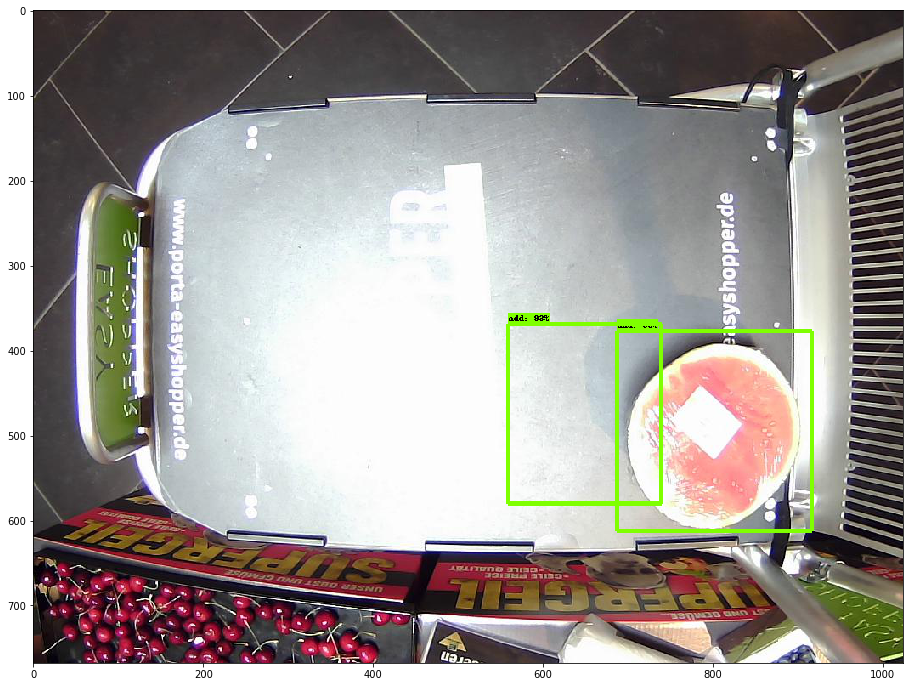

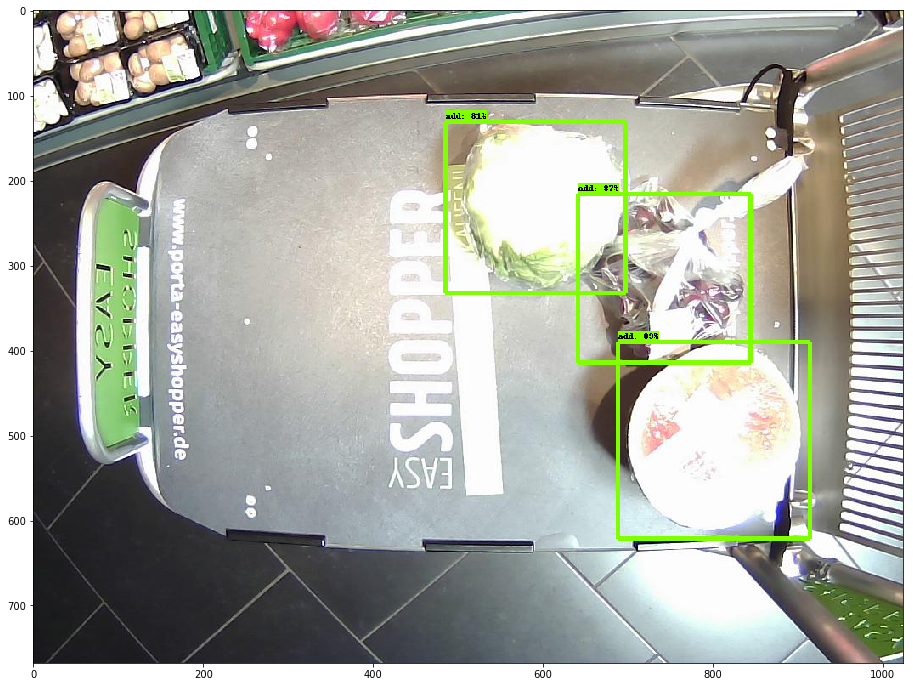

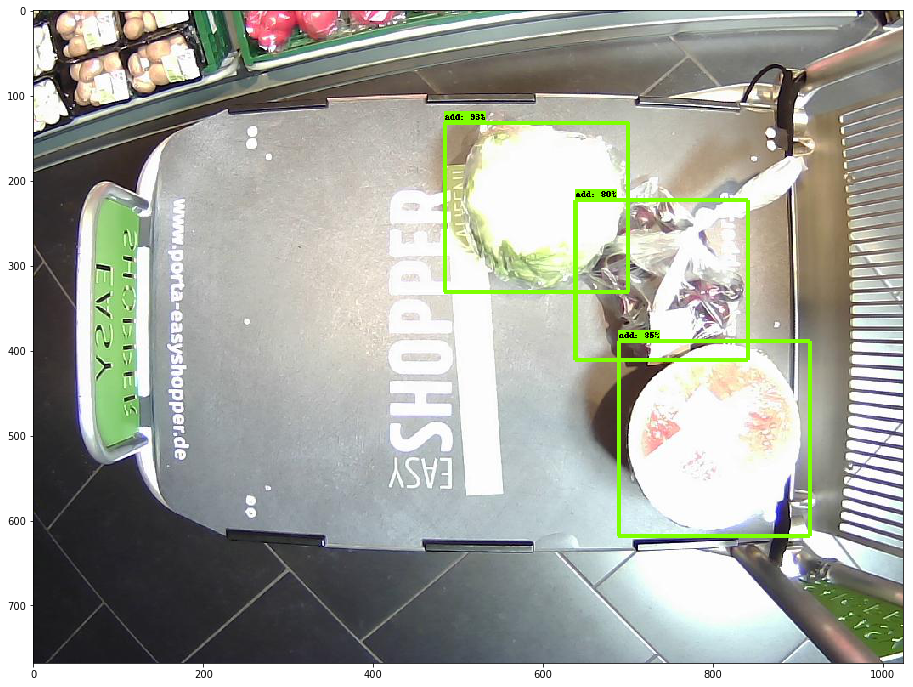

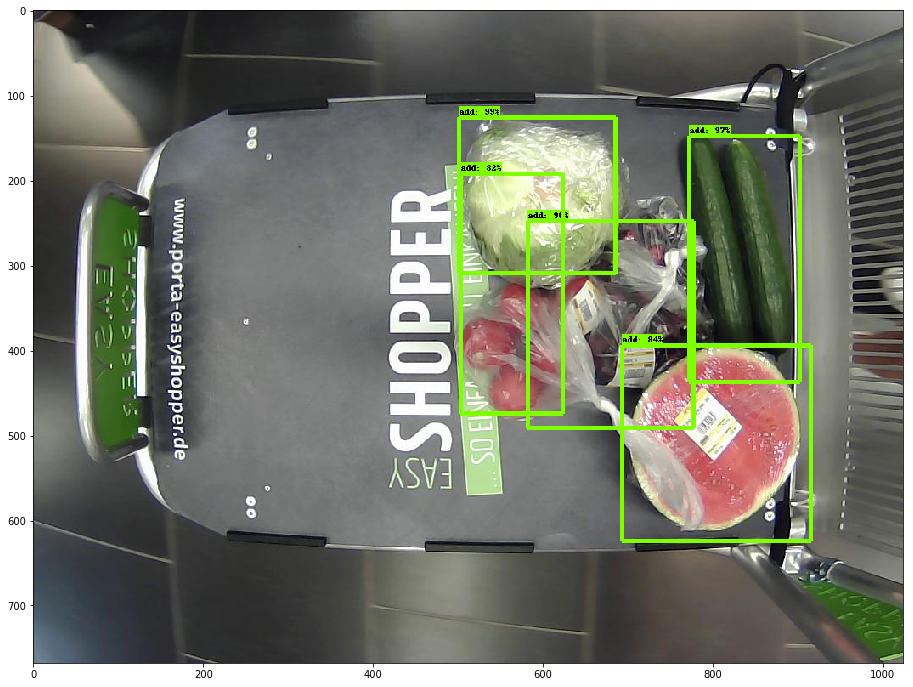

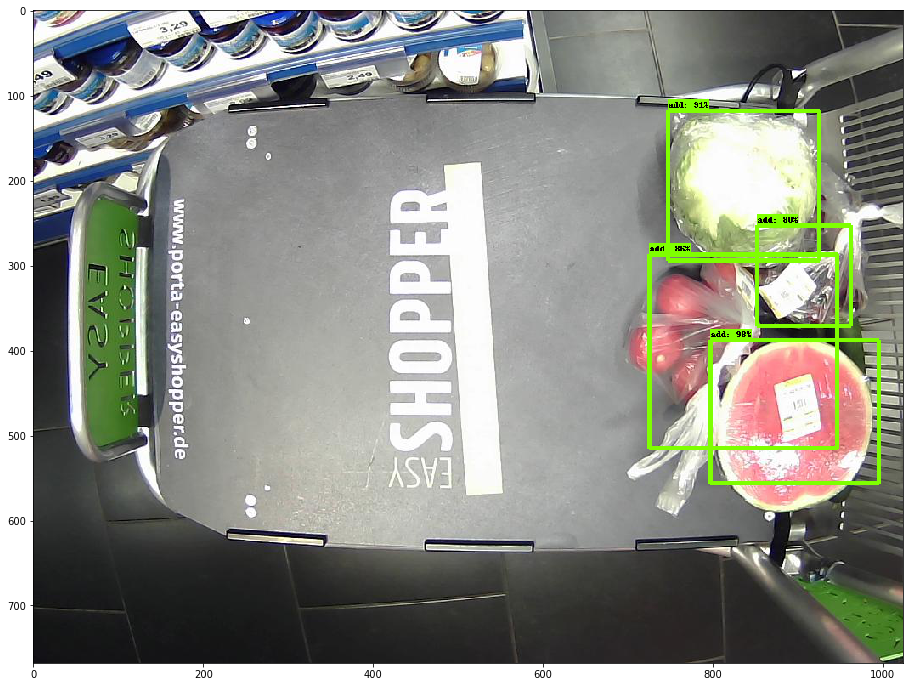

...

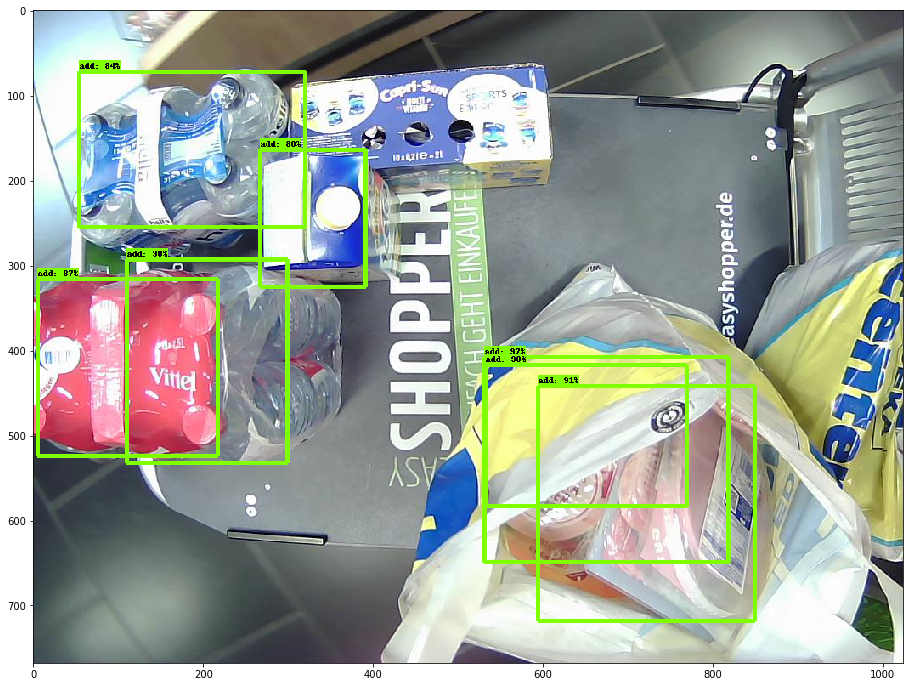

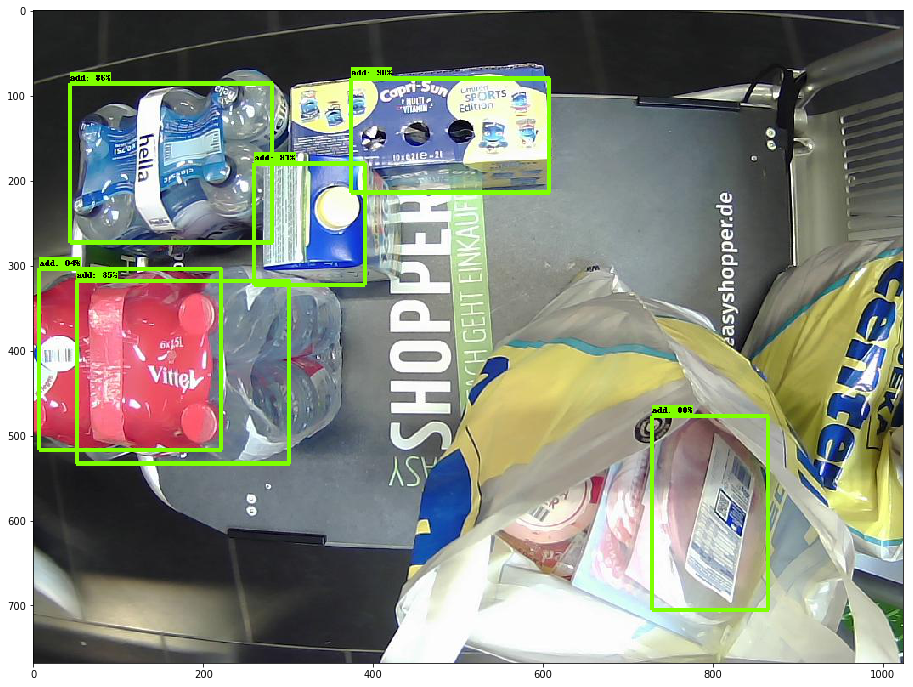

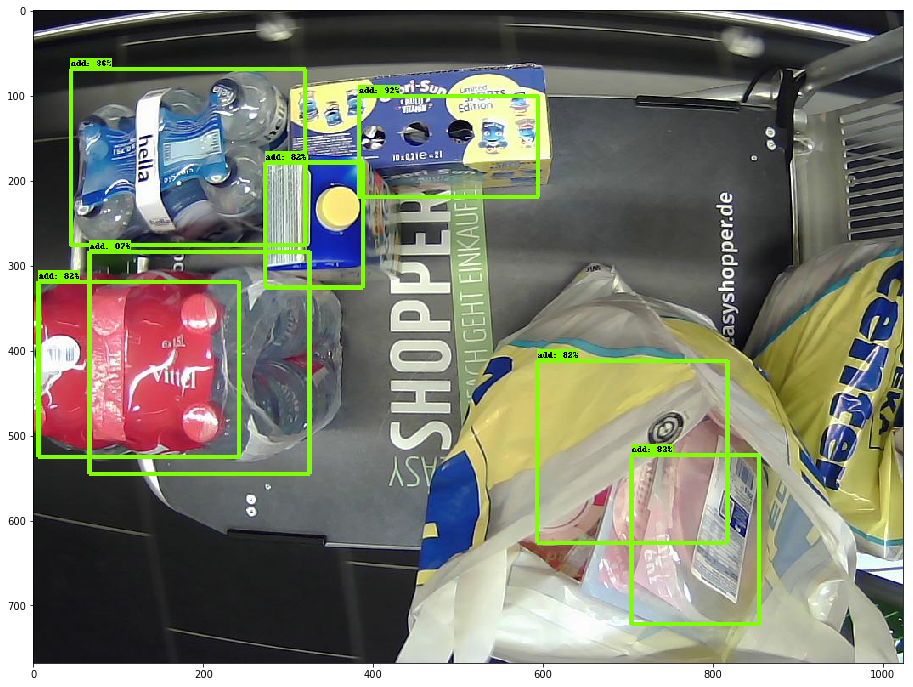

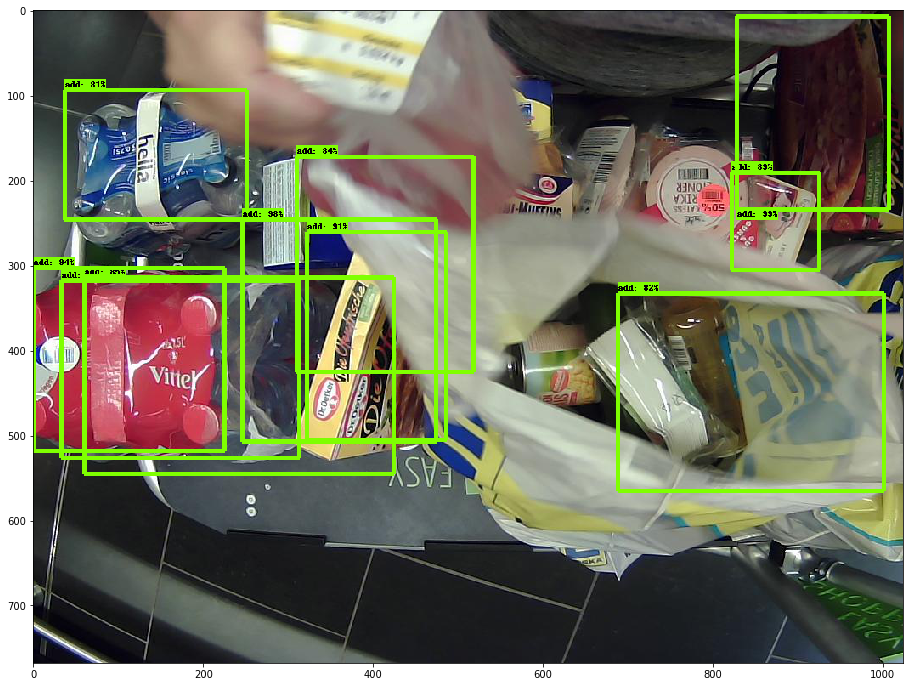

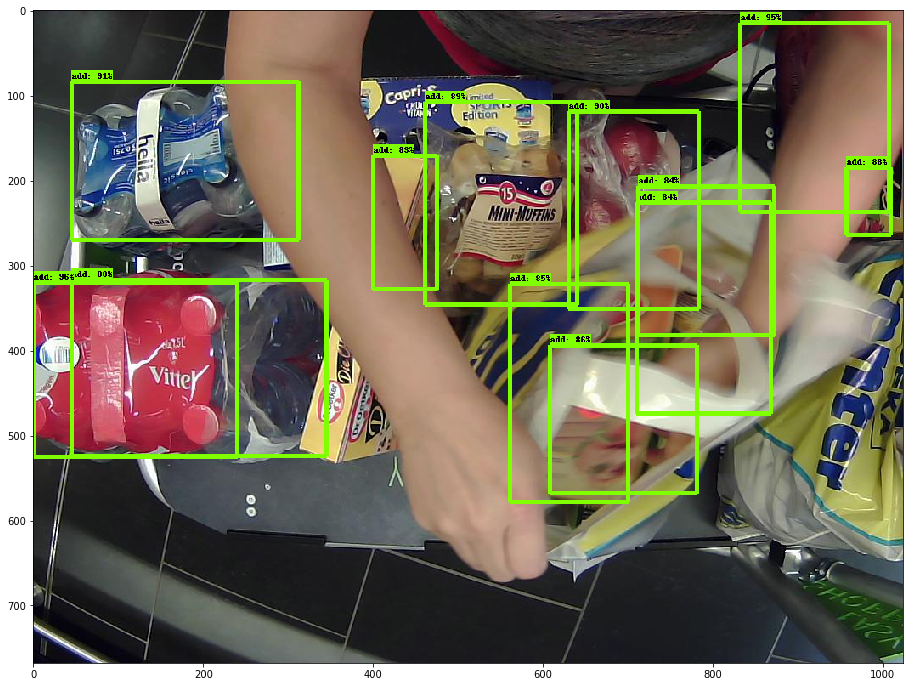

In [26]:
from IPython.display import display, clear_output
clear_output(wait=True)

i=0
for output_dict in output_splitted:
#     not_same = np.where(output_dict["detection_classes"] > 0)
    image_np = output_dict["image_np"]
    image_np_out = np.copy(image_np)
    vis_util.visualize_boxes_and_labels_on_image_array(
          image_np_out,
          output_dict['detection_boxes'],
          output_dict["detection_classes"],
          output_dict['detection_scores'],
          category_index,
          use_normalized_coordinates=True,
          line_thickness=5,
          min_score_thresh=-1)
    plt.figure(figsize=IMAGE_SIZE)
    plt.imshow(image_np_out)
